# Interactive Graph Debugging

Rachel Grace Treene | 4/10/23

This notebook takes the interactive graph code from the flask app and attempts to make it more robust.

In [12]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.figure_factory as ff

data = pd.read_csv("Tax_Record_1867.csv")

### Original Function, Flask-Specific Lines Commented Out

In [17]:
def graph(var_1, var_2, var_3, agg_func, fig_type):

#    var1 = request.form.get("x_col")
#    var2 = request.form.get("y_col")
#    var_3 = request.form.get("group_col")
#    agg_func = request.form.get("agg_func")
#    fig_type = request.form.get("fig_type")

#    data = pd.DataFrame(list(mongo.db["Tax_Record_1867"].find()))

    if var_1 == None or var_2 == None or var_1=="" or var_2=="":
        fig=ff.create_table(data)

    else:
        if agg_func != "":
            new_data = data.groupby(var_1)\
                    .agg({var_2:agg_func})\
                    .reset_index()
            if var_3 != "":
                new_data = data.groupby([var_1, var_3])\
                        .agg({var_2:agg_func})\
                        .reset_index()
        else:
            if var_3 != "":
                new_data = data[[var_1, var_2, var_3]]
            else:
                new_data = data[[var_1, var_2]]
        
        if fig_type=="tab":
            fig=ff.create_table(new_data)
        elif fig_type=="bar":
            if var_3 != "":
                fig = px.bar(new_data, x=var_1, y=var_2, color=var_3,
                            hover_name=var_2,
                            height=600, width=1000)
            else:
                fig = px.bar(new_data, x=var_1, y=var_2, 
                            hover_name=var_2,
                            height=600, width=1000)
        elif fig_type=="scatter":
            if var_3 != "":
                fig = px.scatter(new_data, x=var_1, y=var_2, color=var_3,
                        hover_data=[var_1, var_2, var_3],
                        height=600, width=1000)
            else:
                fig = px.scatter(new_data, x=var_1, y=var_2, 
                        hover_data=[var_1, var_2],
                        height=600, width=1000)
        else:
            fig=ff.create_table(new_data)

    fig.show()
#    graphJSON = json.dumps(fig, cls=plotly.utils.PlotlyJSONEncoder)

#    agg_func_list = ["mean", "median", "count"]
#    fig_type=["tab", "bar", "scatter"]

#    return render_template(
#        "graph_interactive.html",
#        columns=columns,
#        graphJSON=graphJSON,
#        agg_func_list=agg_func_list,
#        fig_type=fig_type
#    )

In [18]:
data.columns

Index(['EventDateYear', 'EventImageLink', 'EventLocJurisdictionCounty',
       'EventTitle', 'PersonEventRole', 'PersonGivenNames',
       'PersonNameAlternate', 'PersonNameSuffix',
       'PersonRoleGivenNamesEmployer', 'PersonRoleLocResidence',
       'PersonRoleLocSurnameEmployer', 'PersonSurname',
       'PersonTaxCommissionerRemarks', 'PersonTaxCountCarriageWagon',
       'PersonTaxCountCattle', 'PersonTaxCountClocks', 'PersonTaxCountHogs',
       'PersonTaxCountHorsesMules', 'PersonTaxCountMusicalInstruments',
       'PersonTaxCountNMalesover16', 'PersonTaxCountSheep',
       'PersonTaxCountWMalesover16', 'PersonTaxCountWatches',
       'PersonTaxLeviedLand', 'PersonTaxStateAll', 'PersonTaxTotalCountyValue',
       'PersonTaxValueAggregatePersonlProperty', 'PersonTaxValueCarriageWagon',
       'PersonTaxValueCattle', 'PersonTaxValueClocks',
       'PersonTaxValueFurnishings', 'PersonTaxValueHogs',
       'PersonTaxValueHorsesMules', 'PersonTaxValueJewelry',
       'PersonTaxValue

#### Test Function to Show Holes

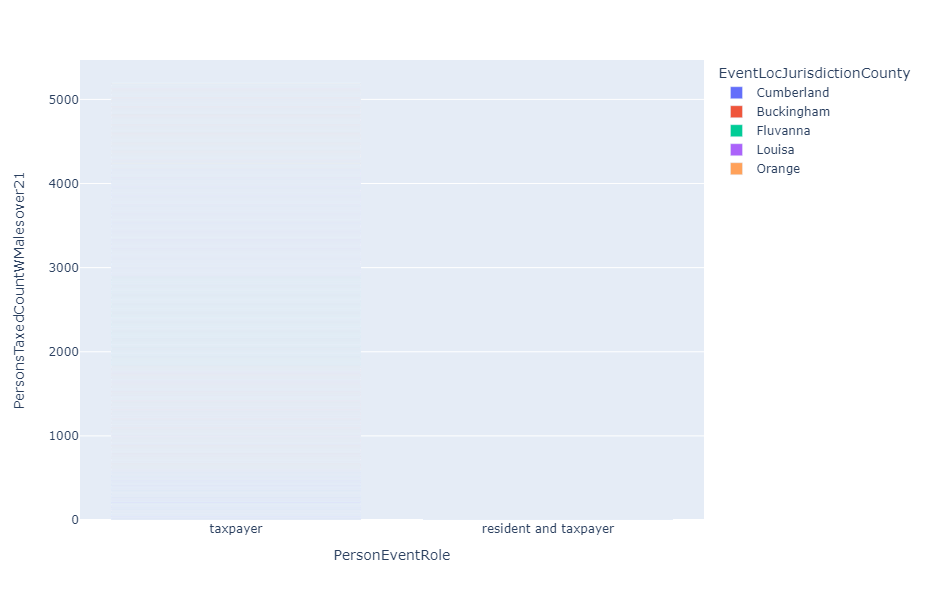

In [19]:
graph('PersonEventRole', 'PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'bar')

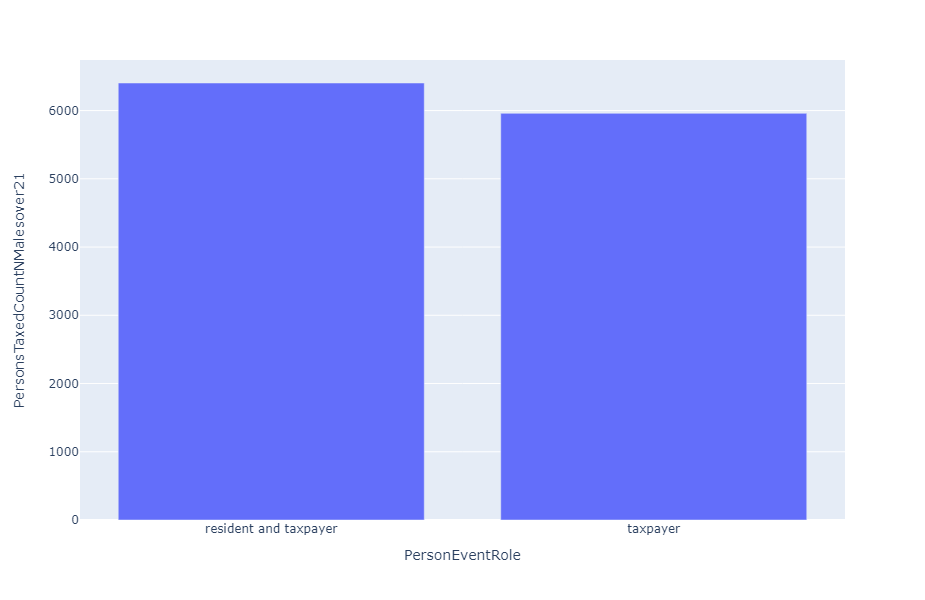

In [20]:
graph('PersonEventRole', 'PersonsTaxedCountNMalesover21', '', 'count', 'bar')

In [70]:
graph('PersonsTaxedCountWMalesover21', '', '', '', 'tab')

KeyboardInterrupt: 

#### Experiment with Plotly `bar`, `scatter`, and `ff.create_table()` to see Capabilities

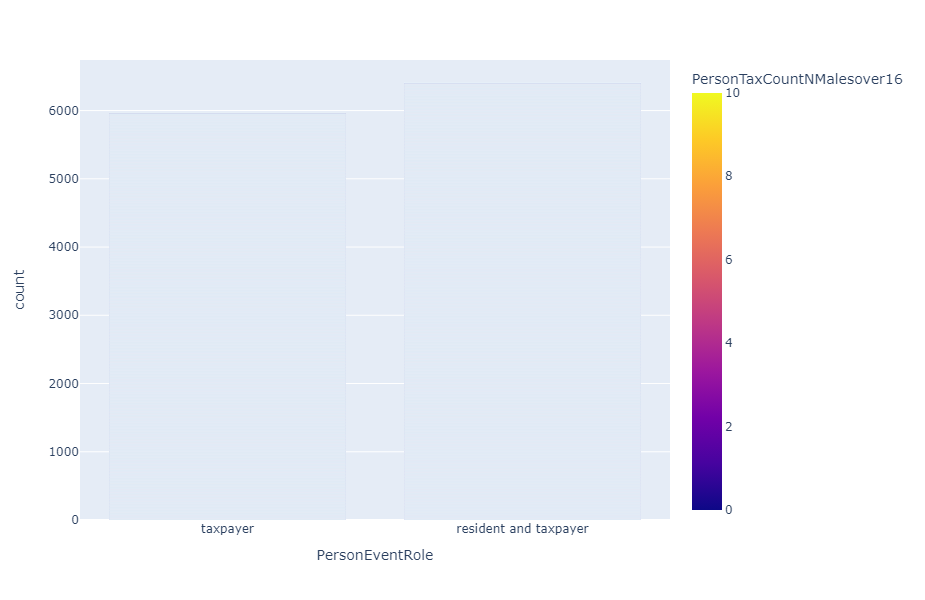

In [47]:
fig = px.bar(data, x='PersonEventRole', #y='PersonsTaxedCountWMalesover21',
            color = 'PersonTaxCountNMalesover16',
            hover_name = 'PersonEventRole',
            height=600, width=1000)
fig.show()

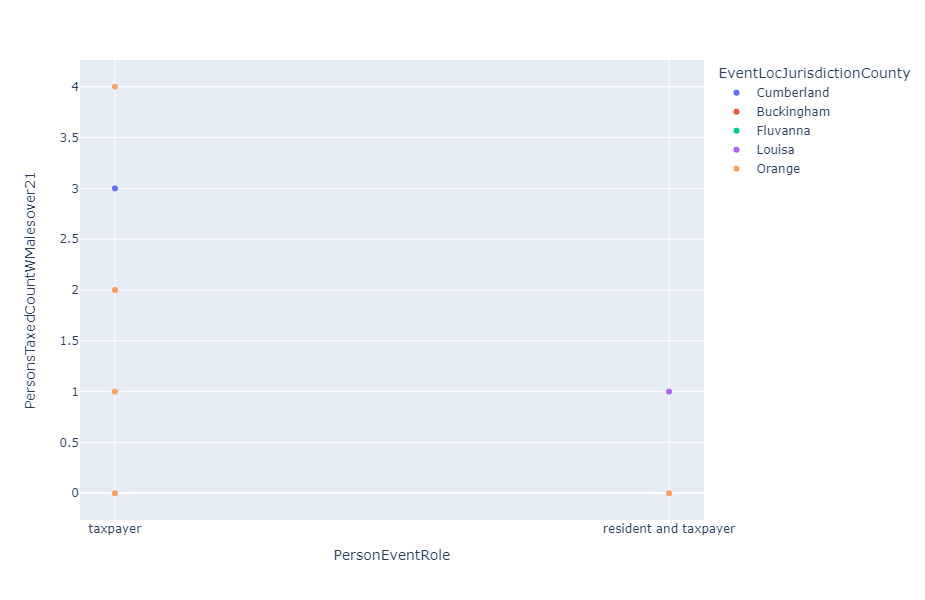

In [57]:
fig = px.scatter(data, x='PersonEventRole', y='PersonsTaxedCountWMalesover21',
            color = 'EventLocJurisdictionCounty',
            hover_name = 'PersonEventRole',
            height=600, width=1000)
fig.show()

In [81]:
fig=ff.create_table(data[['PersonEventRole', 'PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty']].sample(100))

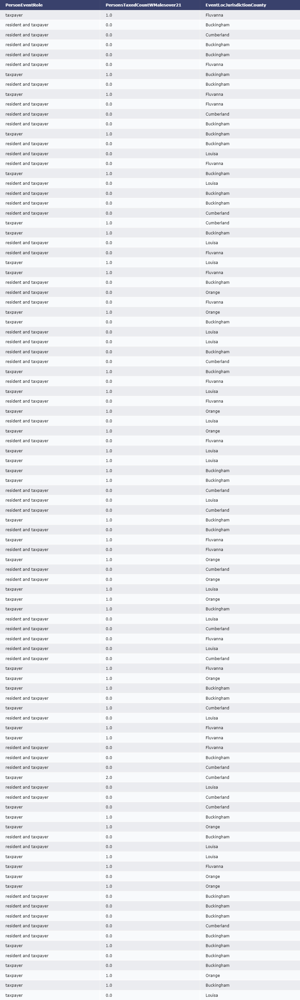

In [82]:
fig.show()

### New Function, Flask-Specific Lines Commented Out

In [94]:
def graph_new(var_1, var_2, var_3, agg_func, fig_type):

#    var1 = request.form.get("x_col")
#    var2 = request.form.get("y_col")
#    var_3 = request.form.get("group_col")
#    agg_func = request.form.get("agg_func")
#    fig_type = request.form.get("fig_type")

#    data = pd.DataFrame(list(mongo.db["Tax_Record_1867"].find()))

    categoricals = ['EventImageLink', 'EventLocJurisdictionCounty',
       'EventTitle', 'PersonEventRole', 'PersonGivenNames',
       'PersonNameAlternate', 'PersonNameSuffix',
       'PersonRoleGivenNamesEmployer', 'PersonRoleLocResidence',
       'PersonRoleLocSurnameEmployer', 'PersonSurname',
       'PersonTaxCommissionerRemarks', 'SourceAuthorName', 'SourceCreator',
       'SourceLocCity', 'SourceLocCreatedCounty', 'SourceLocState',
       'SourceSteward', 'SourceTitle', 'SourceType', '_id']

    # start by specifying which type of visualization the user wants
    # if they don't say, prompt them to specify
    if fig_type == None or fig_type == '':
        error = 'Please specify a visualization type to continue.'
        
    # if they want a bar chart
    elif fig_type == 'bar':
        # if var_1 isn't specified
        if var_1 == None or var_1 == "":
            error = 'Please specify at least an x-value variable to create a bar chart.'
        # if var_1 isn't categorical - need to hardcode, add in here
        elif var_1 not in categoricals:
            error = 'Please specify a categorical x-value variable, not a numeric one.'
        # if var_1 is specified
        else:
            # if they don't specify an agg_func or if it's count
            if agg_func == None or agg_func == "" or agg_func == 'count':
                # if they specify variable 3
                if var_3 != None and var_3 != "":
                    # if they give variables 1 and 2
                    if var_2 != None and var_2 != "":
                        # if variable 2 isn't numeric
                        if var_2 in categoricals:
                            error = 'Please specify a numeric y-value variable, not a categorical one.'
                        # if it is, proceed
                        else:
                            new_data = data[[var_1, var_2, var_3]]
                            fig = px.bar(new_data, x=var_1, y=var_2, color=var_3,
                                    hover_name=var_2,
                                    height=600, width=1000)
                    # if they only give variable 1
                    else:
                        new_data = data[[var_1, var_3]]
                        fig = px.bar(new_data, x=var_1, color=var_3,
                                hover_name=var_3,
                                height=600, width=1000)
                # if they don't specify variable 3
                else:
                    # if they give variables 1 and 2
                    if var_2 != None and var_2 != "":
                        # if variable 2 isn't numeric
                        if var_2 in categoricals:
                            error = 'Please specify a numeric y-value variable, not a categorical one.'
                        # if it is, proceed
                        else:
                            new_data = data[[var_1, var_2]]
                            fig = px.bar(new_data, x=var_1, y=var_2,
                                    hover_name=var_2,
                                    height=600, width=1000)
                    # if they only give variable 1
                    else:
                        new_data = data[[var_1]]
                        fig = px.bar(new_data, x=var_1,
                                hover_name=var_1,
                                height=600, width=1000)
            # if the agg_func is mean
            elif agg_func == 'mean':
                # if they specify variable 3
                if var_3 != None and var_3 != "":
                    # if they give variables 1 and 2
                    if var_2 != None and var_2 != "":
                        if var_2 in categoricals:
                            error = 'Please specify a numeric y-value variable, not a categorical one.'
                        # if it is, proceed
                        else:
                            new_data = data.groupby([var_1, var_3])\
                                    .agg({var_2:agg_func})\
                                    .reset_index()
                            fig = px.bar(new_data, x=var_1, y=var_2, color=var_3,
                                    hover_name=var_2,
                                    height=600, width=1000)
                    # if they only give variable 1
                    else:
                        error = 'Please specify a y-value variable to use the aggregation function "mean."'
                # if they don't specify variable 3
                else:
                    # if they give variables 1 and 2
                    if var_2 != None and var_2 != "":
                        # if variable 2 isn't numeric
                        if var_2 in categoricals:
                            error = 'Please specify a numeric y-value variable, not a categorical one.'
                        # if it is, proceed
                        else:
                            new_data = data.groupby(var_1)\
                                    .agg({var_2:agg_func})\
                                    .reset_index()
                            fig = px.bar(new_data, x=var_1, y=var_2,
                                    hover_name=var_2,
                                    height=600, width=1000)
                    # if they only give variable 1
                    else:
                        error = 'Please specify a y-value variable to use the aggregation function "mean."'
            # if the agg_func is median
            elif agg_func == 'median':
                # if they specify variable 3
                if var_3 != None and var_3 != "":
                    # if they give variables 1 and 2
                    if var_2 != None and var_2 != "":
                        # if variable 2 isn't numeric
                        if var_2 in categoricals:
                            error = 'Please specify a numeric y-value variable, not a categorical one.'
                        # if it is, proceed
                        else:
                            new_data = data.groupby([var_1, var_3])\
                                    .agg({var_2:agg_func})\
                                    .reset_index()
                            fig = px.bar(new_data, x=var_1, y=var_2, color=var_3,
                                    hover_name=var_2,
                                    height=600, width=1000)
                    # if they only give variable 1
                    else:
                        error = 'Please specify a y-value variable to use the aggregation function "median."'
                # if they don't specify variable 3
                else:
                    # if they give variables 1 and 2
                    if var_2 != None and var_2 != "":
                        # if variable 2 isn't numeric
                        if var_2 in categoricals:
                            error = 'Please specify a numeric y-value variable, not a categorical one.'
                        # if it is, proceed
                        else:
                            new_data = data.groupby(var_1)\
                                    .agg({var_2:agg_func})\
                                    .reset_index()
                            fig = px.bar(new_data, x=var_1, y=var_2,
                                    hover_name=var_2,
                                    height=600, width=1000)
                    # if they only give variable 1
                    else:
                        error = 'Please specify a y-value variable to use the aggregation function "median."'
   
    # if they want a scatterplot
    elif fig_type == 'scatter':
        # if var_1 isn't specified
        if var_1 == None or var_1 == "":
            error = 'Please specify an x-value variable to create a scatter plot.'
        # if var_1 isn't numeric
        elif var_1 in categoricals:
            error = 'Please specify a numeric x-value variable, not a categorical one.'
        # if var_1 is specified
        else:
            # note all agg_funcs work here, and don't change the code needed to plot the data
            # if they specify variable 3, variable 2 must be numeric
            if var_3 != None and var_3 != "":
                # if they give variables 1 and 2
                if var_2 != None and var_2 != "":
                    # if variable 2 isn't numeric
                    if var_2 in categoricals:
                        error = 'Please specify a numeric y-value variable, not a categorical one.'
                    # if it is, proceed
                    else:
                        new_data = data[[var_1, var_2, var_3]]
                        fig = px.scatter(new_data, x=var_1, y=var_2, color=var_3,
                            hover_data=[var_1, var_2, var_3],
                            height=600, width=1000)
                # if they only give variable 1
                else:
                    error = 'Please select at least an x-value variable and a y-value variable. If you only want to select one variable, consider a bar chart or table.'
            # if they don't specify variable 3, variable 2 can be categorical
            else:
                # if they give variables 1 and 2
                if var_2 != None and var_2 != "":
                    new_data = data[[var_1, var_2]]
                    fig = px.scatter(new_data, x=var_1, y=var_2,
                        hover_data=[var_1, var_2],
                        height=600, width=1000)
                # if they only give variable 1
                else:
                    error = 'Please select at least an x-value variable and a y-value variable. If you only want to select one variable, consider a bar chart or table.'

    # if they want a table
    elif fig_type == 'tab':
        # if they specified an agg_func
        if agg_func != None and agg_func != "":
            error = 'To create a table, don\'t select an aggregation function. If you want to use one, consider a bar chart or scatter plot.'
        # if no agg_func
        else:
            # if var_1 doesn't exist
            if var_1 == None or var_1 == "":
                error = 'Please specify an x-value variable to create a table.'
            # if var_1 does exist
            else:
                # if var_2 doesn't exist
                if var_2 == None or var_2 == "":
                    # if var_3 doesn't exist
                    if var_3 == None or var_3 == "":
                        fig=ff.create_table(data[[var_1]].sample(100))
                    # if var_3 does exist
                    else:
                        fig=ff.create_table(data[[var_1, var_3]].sample(100))
                # if var_2 does exist
                else:
                    # if var_3 doesn't exist
                    if var_3 == None or var_3 == "":
                        fig=ff.create_table(data[[var_1, var_2]].sample(100))
                    # if var_3 does exist
                    else:
                        fig=ff.create_table(data[[var_1, var_2, var_3]].sample(100))

    try:
        print(error)
    except NameError:
        pass

    try:
        fig.show()
    except NameError:
        pass
#    graphJSON = json.dumps(fig, cls=plotly.utils.PlotlyJSONEncoder)

#    agg_func_list = ["mean", "median", "count"]
#    fig_type=["tab", "bar", "scatter"]

#    return render_template(
#        "graph_interactive.html",
#        columns=columns,
#        graphJSON=graphJSON,
#        agg_func_list=agg_func_list,
#        fig_type=fig_type,
#        errorMessage = error
#    )

### Test New Function

**Empty**

Syntax: graph_new(var_1, var_2, var_3, agg_func, fig_type)

categorical: 'PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle'

numeric: 'PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand'

Test cases:
- empty
    - graph_new('', '', '', '', '')
    - graph_new(categorical, '', '', '', '')
    - graph_new(numeric, '', '', '', '')

In [98]:
graph_new('', '', '', '', '')

Please specify a visualization type to continue.


In [99]:
graph_new('PersonEventRole', '', '', '', '')

Please specify a visualization type to continue.


In [100]:
graph_new('PersonsTaxedCountWMalesover21', '', '', '', '')

Please specify a visualization type to continue.


**Fig Type**

Syntax: graph_new(var_1, var_2, var_3, agg_func, fig_type)

categorical: 'PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle'

numeric: 'PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand'

Test cases:
- fig_type
    - graph_new(categorical, '', '', '', 'bar')
    - graph_new(categorical, '', '', '', 'tab')
    - graph_new(categorical, '', '', '', 'scatter')
    - graph_new(numeric, '', '', '', 'bar')
    - graph_new(numeric, '', '', '', 'tab')
    - graph_new(numeric, '', '', '', 'scatter')

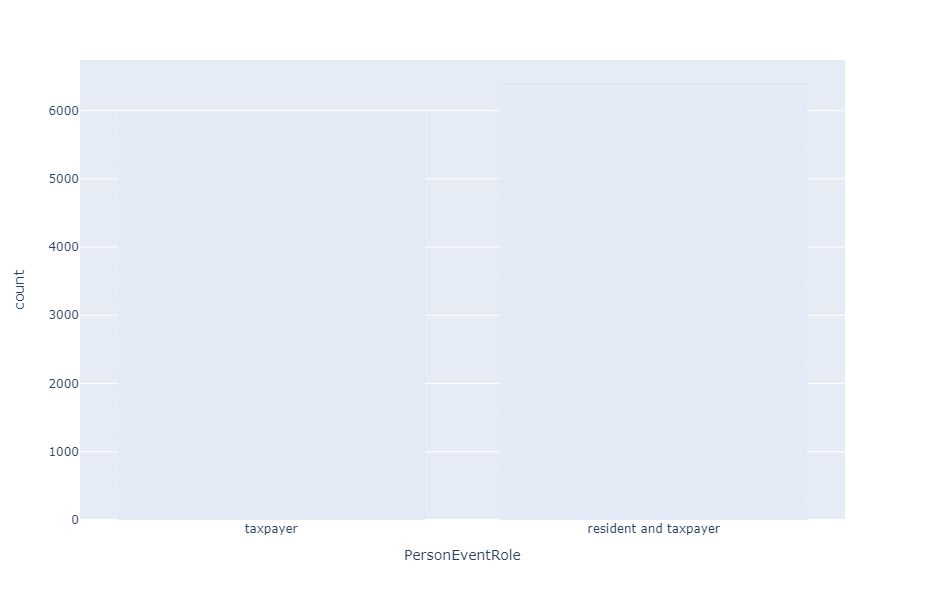

In [101]:
graph_new('PersonEventRole', '', '', '', 'bar')

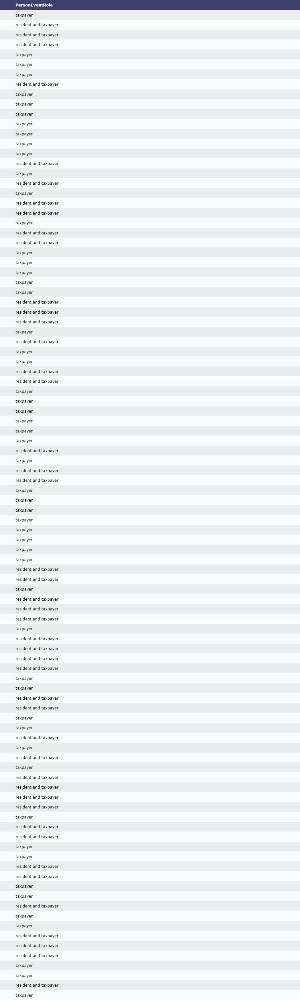

In [102]:
graph_new('PersonEventRole', '', '', '', 'tab')

In [103]:
graph_new('PersonEventRole', '', '', '', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [104]:
graph_new('PersonsTaxedCountWMalesover21', '', '', '', 'bar')

Please specify a categorical x-value variable, not a numeric one.


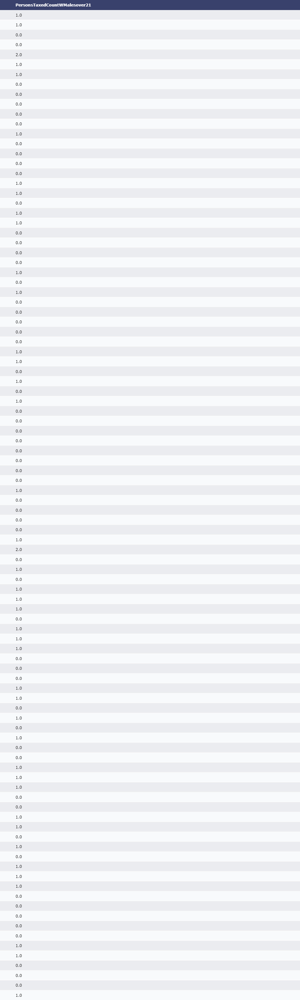

In [105]:
graph_new('PersonsTaxedCountWMalesover21', '', '', '', 'tab')

In [106]:
graph_new('PersonsTaxedCountWMalesover21', '', '', '', 'scatter')

Please select at least an x-value variable and a y-value variable. If you only want to select one variable, consider a bar chart or table.


**Agg Func**

Syntax: graph_new(var_1, var_2, var_3, agg_func, fig_type)

categorical: 'PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle'

numeric: 'PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand'

- agg_func
    - graph_new(categorical, '', '', 'mean', 'bar')
    - graph_new(categorical, '', '', 'median', 'bar')
    - graph_new(categorical, '', '', 'count', 'bar')
    - graph_new(categorical, '', '', 'mean', 'tab')
    - graph_new(categorical, '', '', 'median', 'tab')
    - graph_new(categorical, '', '', 'count', 'tab')
    - graph_new(categorical, '', '', 'mean', 'scatter')
    - graph_new(categorical, '', '', 'median', 'scatter')
    - graph_new(categorical, '', '', 'count', 'scatter')
    - graph_new(numeric, '', '', 'mean', 'bar')
    - graph_new(numeric, '', '', 'median', 'bar')
    - graph_new(numeric, '', '', 'count', 'bar')
    - graph_new(numeric, '', '', 'mean', 'tab')
    - graph_new(numeric, '', '', 'median', 'tab')
    - graph_new(numeric, '', '', 'count', 'tab')
    - graph_new(numeric, '', '', 'mean', 'scatter')
    - graph_new(numeric, '', '', 'median', 'scatter')
    - graph_new(numeric, '', '', 'count', 'scatter')

In [107]:
graph_new('PersonEventRole', '', '', 'mean', 'bar')

Please specify a y-value variable to use the aggregation function "mean."


In [108]:
graph_new('PersonEventRole', '', '', 'median', 'bar')

Please specify a y-value variable to use the aggregation function "median."


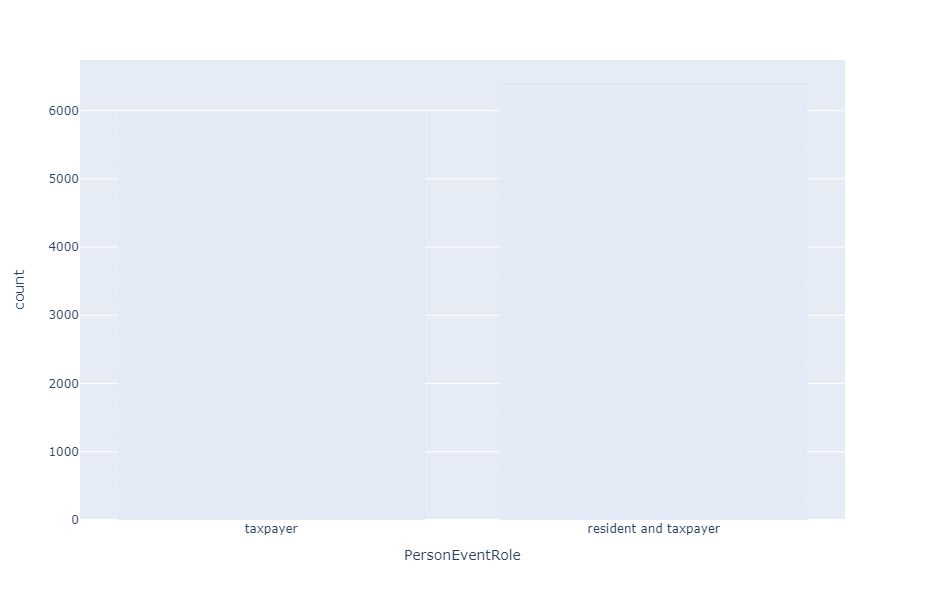

In [109]:
graph_new('PersonEventRole', '', '', 'count', 'bar')

In [110]:
graph_new('PersonEventRole', '', '', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [111]:
graph_new('PersonEventRole', '', '', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [112]:
graph_new('PersonEventRole', '', '', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [113]:
graph_new('PersonEventRole', '', '', 'mean', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [114]:
graph_new('PersonEventRole', '', '', 'median', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [115]:
graph_new('PersonEventRole', '', '', 'count', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [116]:
graph_new('PersonsTaxedCountWMalesover21', '', '', 'mean', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [117]:
graph_new('PersonsTaxedCountWMalesover21', '', '', 'median', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [118]:
graph_new('PersonsTaxedCountWMalesover21', '', '', 'count', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [119]:
graph_new('PersonsTaxedCountWMalesover21', '', '', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [120]:
graph_new('PersonsTaxedCountWMalesover21', '', '', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [121]:
graph_new('PersonsTaxedCountWMalesover21', '', '', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [122]:
graph_new('PersonsTaxedCountWMalesover21', '', '', 'mean', 'scatter')

Please select at least an x-value variable and a y-value variable. If you only want to select one variable, consider a bar chart or table.


In [123]:
graph_new('PersonsTaxedCountWMalesover21', '', '', 'median', 'scatter')

Please select at least an x-value variable and a y-value variable. If you only want to select one variable, consider a bar chart or table.


In [124]:
graph_new('PersonsTaxedCountWMalesover21', '', '', 'count', 'scatter')

Please select at least an x-value variable and a y-value variable. If you only want to select one variable, consider a bar chart or table.


**Variable 2**

Syntax: graph_new(var_1, var_2, var_3, agg_func, fig_type)

categorical: 'PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle'

numeric: 'PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand'

- var_2
    - graph_new(categorical, 'categorical', '', 'mean', 'bar')
    - graph_new(categorical, 'numeric', '', 'mean', 'bar')
    - graph_new(categorical, 'categorical', '', 'median', 'bar')
    - graph_new(categorical, 'numeric', '', 'median', 'bar')
    - graph_new(categorical, 'categorical', '', 'count', 'bar')
    - graph_new(categorical, 'numeric', '', 'count', 'bar')
    - graph_new(categorical, 'categorical', '', 'mean', 'tab')
    - graph_new(categorical, 'numeric', '', 'mean', 'tab')
    - graph_new(categorical, 'categorical', '', 'median', 'tab')
    - graph_new(categorical, 'numeric', '', 'median', 'tab')
    - graph_new(categorical, 'categorical', '', 'count', 'tab')
    - graph_new(categorical, 'numeric', '', 'count', 'tab')
    - graph_new(categorical, 'categorical', '', 'mean', 'scatter')
    - graph_new(categorical, 'numeric', '', 'mean', 'scatter')
    - graph_new(categorical, 'categorical', '', 'median', 'scatter')
    - graph_new(categorical, 'numeric', '', 'median', 'scatter')
    - graph_new(categorical, 'categorical', '', 'count', 'scatter')
    - graph_new(categorical, 'numeric', '', 'count', 'scatter')
    - graph_new(numeric, 'categorical', '', 'mean', 'bar')
    - graph_new(numeric, 'numeric', '', 'mean', 'bar')
    - graph_new(numeric, 'categorical', '', 'median', 'bar')
    - graph_new(numeric, 'numeric', '', 'median', 'bar')
    - graph_new(numeric, 'categorical', '', 'count', 'bar')
    - graph_new(numeric, 'numeric', '', 'count', 'bar')
    - graph_new(numeric, 'categorical', '', 'mean', 'tab')
    - graph_new(numeric, 'numeric', '', 'mean', 'tab')
    - graph_new(numeric, 'categorical', '', 'median', 'tab')
    - graph_new(numeric, 'numeric', '', 'median', 'tab')
    - graph_new(numeric, 'categorical', '', 'count', 'tab')
    - graph_new(numeric, 'numeric', '', 'count', 'tab')
    - graph_new(numeric, 'categorical', '', 'mean', 'scatter')
    - graph_new(numeric, 'numeric', '', 'mean', 'scatter')
    - graph_new(numeric, 'categorical', '', 'median', 'scatter')
    - graph_new(numeric, 'numeric', '', 'median', 'scatter')
    - graph_new(numeric, 'categorical', '', 'count', 'scatter')
    - graph_new(numeric, 'numeric', '', 'count', 'scatter')
    

In [125]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', '', 'mean', 'bar')

Please specify a numeric y-value variable, not a categorical one.


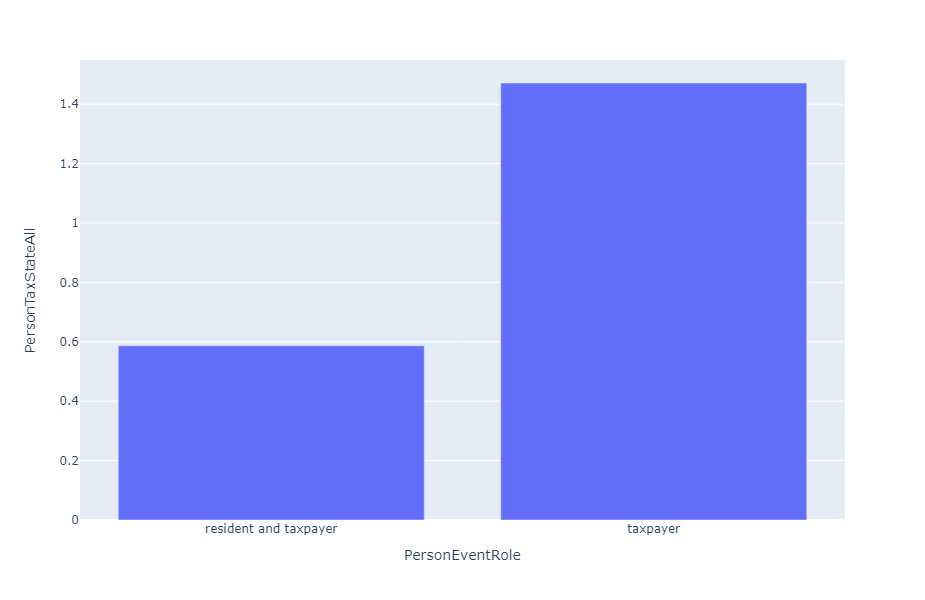

In [126]:
graph_new('PersonEventRole', 'PersonTaxStateAll', '', 'mean', 'bar')

In [127]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', '', 'median', 'bar')

Please specify a numeric y-value variable, not a categorical one.


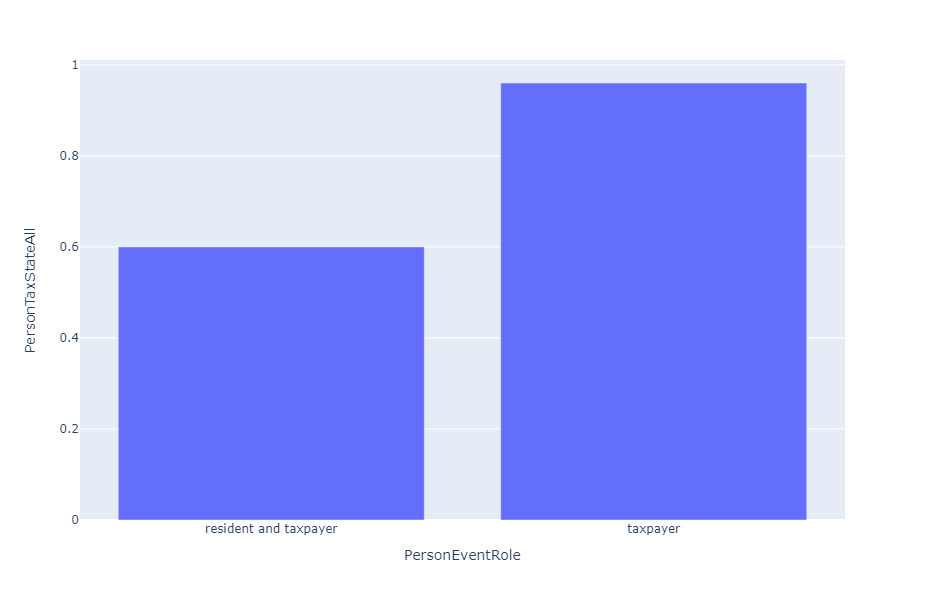

In [128]:
graph_new('PersonEventRole', 'PersonTaxStateAll', '', 'median', 'bar')

In [129]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', '', 'count', 'bar')

Please specify a numeric y-value variable, not a categorical one.


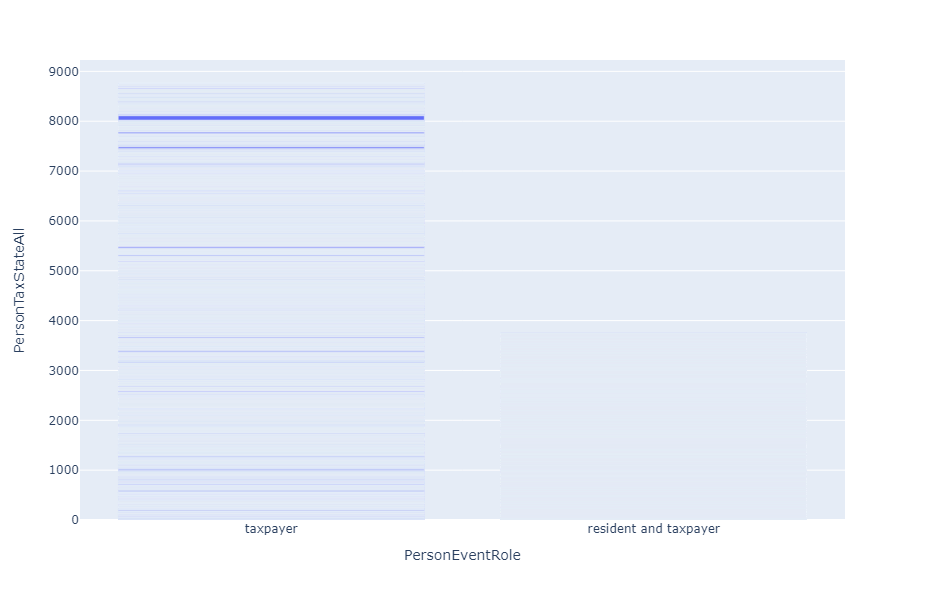

In [130]:
graph_new('PersonEventRole', 'PersonTaxStateAll', '', 'count', 'bar')

In [131]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', '', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [132]:
graph_new('PersonEventRole', 'PersonTaxStateAll', '', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [133]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', '', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [134]:
graph_new('PersonEventRole', 'PersonTaxStateAll', '', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [135]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', '', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [136]:
graph_new('PersonEventRole', 'PersonTaxStateAll', '', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [137]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', '', 'mean', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [138]:
graph_new('PersonEventRole', 'PersonTaxStateAll', '', 'mean', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [139]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', '', 'median', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [140]:
graph_new('PersonEventRole', 'PersonTaxStateAll', '', 'median', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [141]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', '', 'count', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [142]:
graph_new('PersonEventRole', 'PersonTaxStateAll', '', 'count', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [143]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'mean', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [144]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', '', 'mean', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [145]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'median', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [146]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', '', 'median', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [147]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'count', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [148]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', '', 'count', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [149]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [150]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', '', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [151]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [152]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', '', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [153]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [154]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', '', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


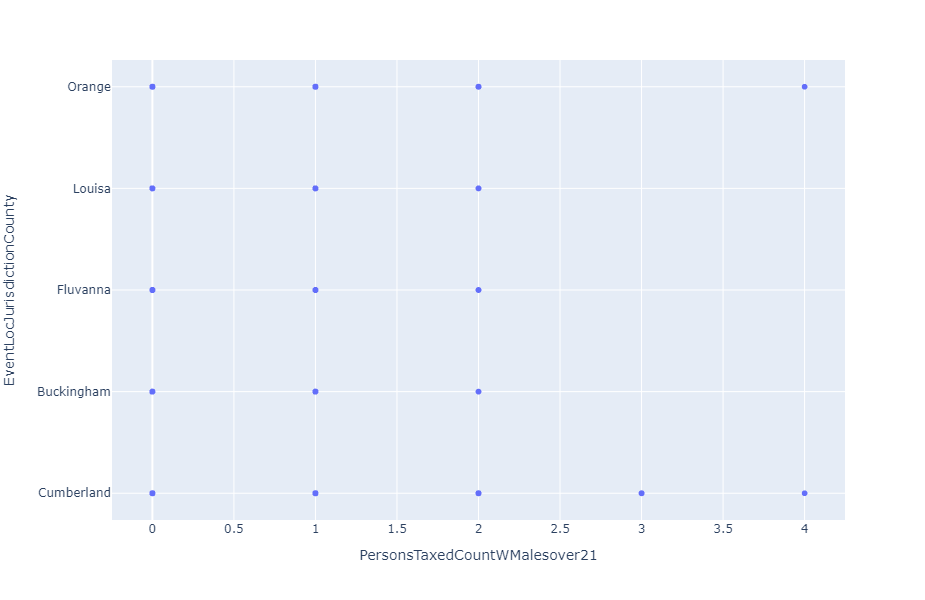

In [155]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'mean', 'scatter')

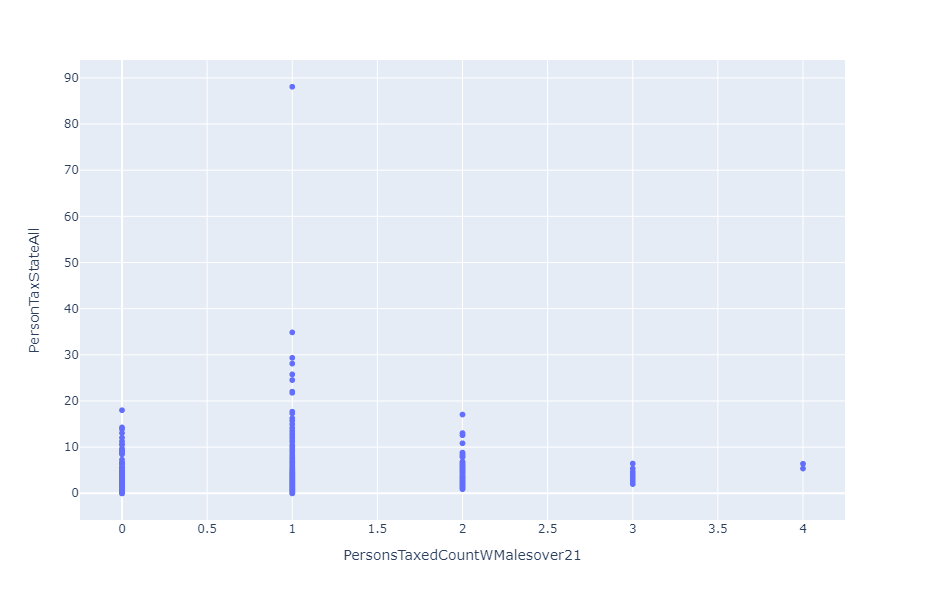

In [156]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', '', 'mean', 'scatter')

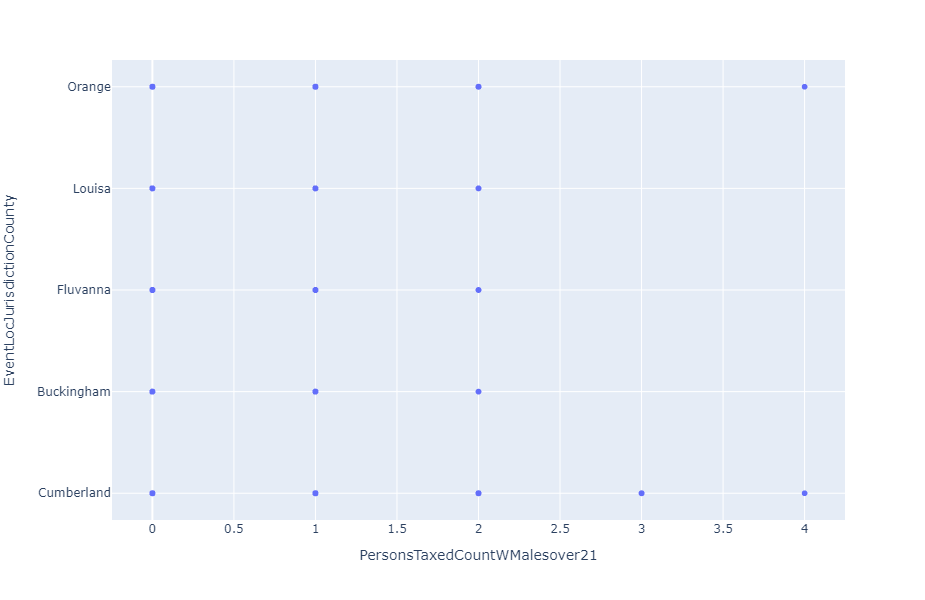

In [157]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'median', 'scatter')

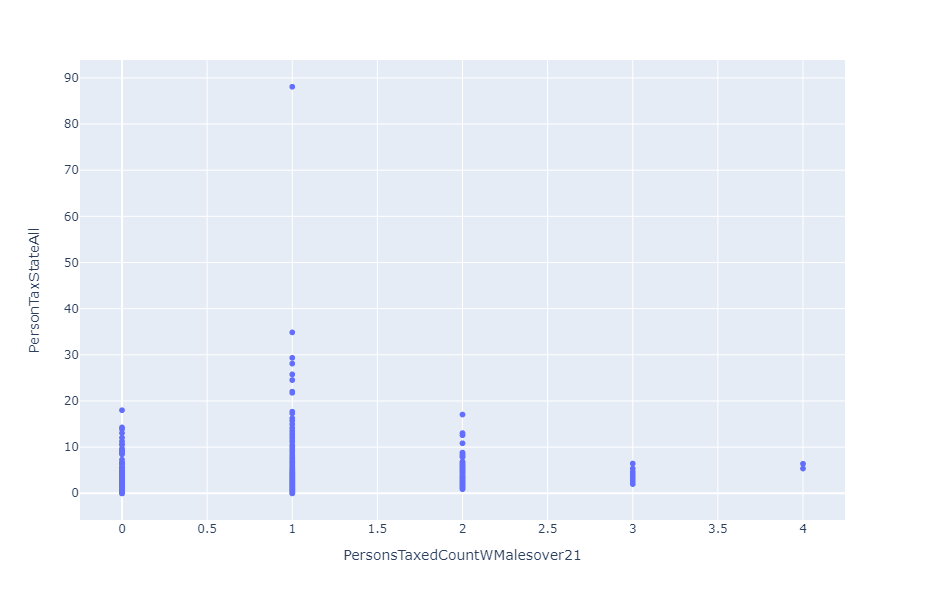

In [158]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', '', 'median', 'scatter')

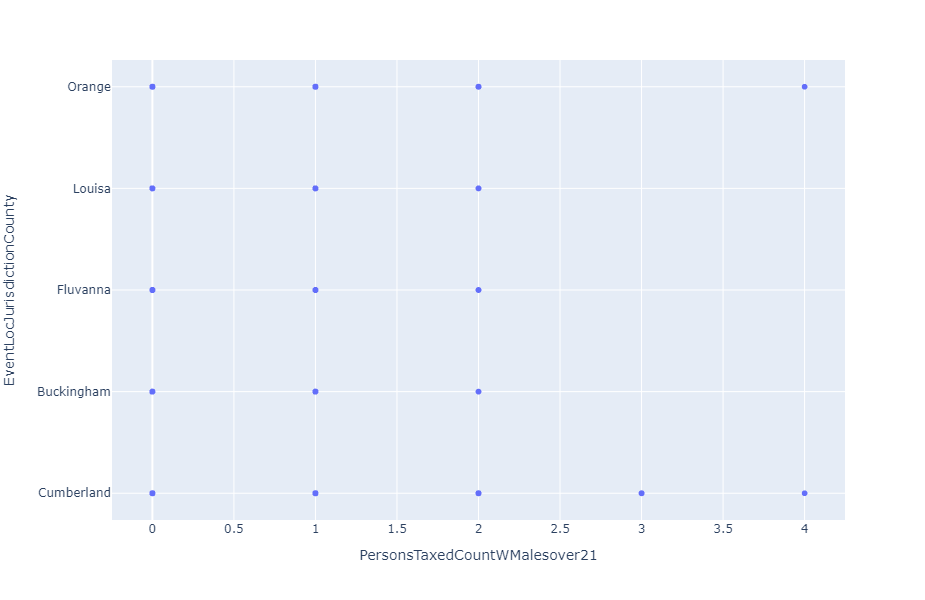

In [159]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', '', 'count', 'scatter')

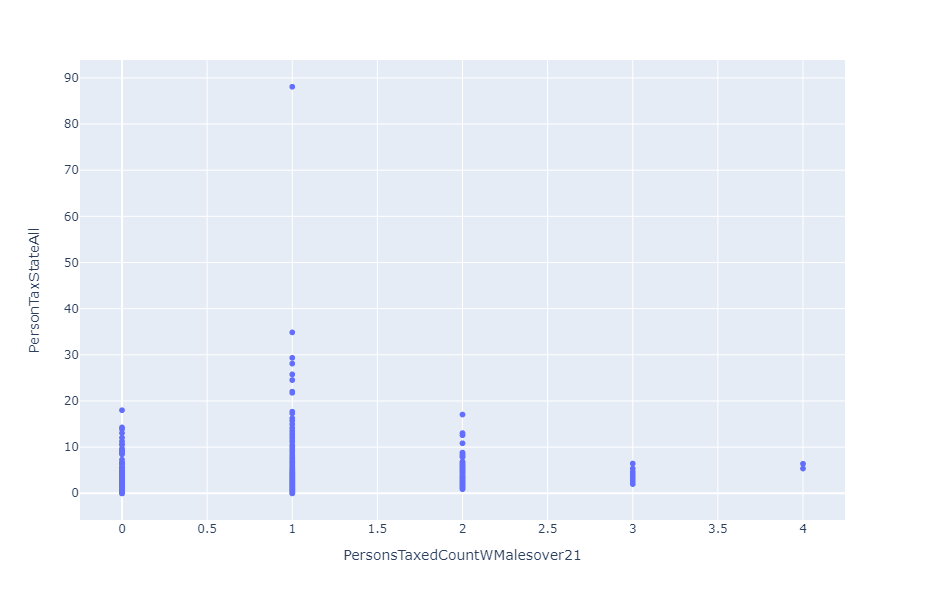

In [160]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', '', 'count', 'scatter')

**Variable 3**

Syntax: graph_new(var_1, var_2, var_3, agg_func, fig_type)

categorical: 'PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle'

numeric: 'PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand'

- var_3
    - graph_new(categorical, 'categorical', 'categorical', 'mean', 'bar')
    - graph_new(categorical, 'numeric', 'categorical', 'mean', 'bar')
    - graph_new(categorical, 'categorical', 'numeric', 'mean', 'bar')
    - graph_new(categorical, 'numeric', 'numeric', 'mean', 'bar')
    - graph_new(categorical, 'categorical', 'categorical', 'median', 'bar')
    - graph_new(categorical, 'numeric', 'categorical', 'median', 'bar')
    - graph_new(categorical, 'categorical', 'numeric', 'median', 'bar')
    - graph_new(categorical, 'numeric', 'numeric', 'median', 'bar')
    - graph_new(categorical, 'categorical', 'categorical', 'count', 'bar')
    - graph_new(categorical, 'numeric', 'categorical', 'count', 'bar')
    - graph_new(categorical, 'categorical', 'numeric', 'count', 'bar')
    - graph_new(categorical, 'numeric', 'numeric', 'count', 'bar')
    - graph_new(categorical, 'categorical', 'categorical', 'mean', 'tab')
    - graph_new(categorical, 'numeric', 'categorical', 'mean', 'tab')
    - graph_new(categorical, 'categorical', 'numeric', 'mean', 'tab')
    - graph_new(categorical, 'numeric', 'numeric', 'mean', 'tab')
    - graph_new(categorical, 'categorical', 'categorical', 'median', 'tab')
    - graph_new(categorical, 'numeric', 'categorical', 'median', 'tab')
    - graph_new(categorical, 'categorical', 'numeric', 'median', 'tab')
    - graph_new(categorical, 'numeric', 'numeric', 'median', 'tab')
    - graph_new(categorical, 'categorical', 'categorical', 'count', 'tab')
    - graph_new(categorical, 'numeric', 'categorical', 'count', 'tab')
    - graph_new(categorical, 'categorical', 'numeric', 'count', 'tab')
    - graph_new(categorical, 'numeric', 'numeric', 'count', 'tab')
    - graph_new(categorical, 'categorical', 'categorical', 'mean', 'scatter')
    - graph_new(categorical, 'numeric', 'categorical', 'mean', 'scatter')
    - graph_new(categorical, 'categorical', 'numeric', 'mean', 'scatter')
    - graph_new(categorical, 'numeric', 'numeric', 'mean', 'scatter')
    - graph_new(categorical, 'categorical', 'categorical', 'median', 'scatter')
    - graph_new(categorical, 'numeric', 'categorical', 'median', 'scatter')
    - graph_new(categorical, 'categorical', 'numeric', 'median', 'scatter')
    - graph_new(categorical, 'numeric', 'numeric', 'median', 'scatter')
    - graph_new(categorical, 'categorical', 'categorical', 'count', 'scatter')
    - graph_new(categorical, 'numeric', 'categorical', 'count', 'scatter')
    - graph_new(categorical, 'categorical', 'numeric', 'count', 'scatter')
    - graph_new(categorical, 'numeric', 'numeric', 'count', 'scatter')
    - graph_new(numeric, 'categorical', 'categorical', 'mean', 'bar')
    - graph_new(numeric, 'numeric', 'categorical', 'mean', 'bar')
    - graph_new(numeric, 'categorical', 'numeric', 'mean', 'bar')
    - graph_new(numeric, 'numeric', 'numeric', 'mean', 'bar')
    - graph_new(numeric, 'categorical', 'categorical', 'median', 'bar')
    - graph_new(numeric, 'numeric', 'categorical', 'median', 'bar')
    - graph_new(numeric, 'categorical', 'numeric', 'median', 'bar')
    - graph_new(numeric, 'numeric', 'numeric', 'median', 'bar')
    - graph_new(numeric, 'categorical', 'categorical', 'count', 'bar')
    - graph_new(numeric, 'numeric', 'categorical', 'count', 'bar')
    - graph_new(numeric, 'categorical', 'numeric', 'count', 'bar')
    - graph_new(numeric, 'numeric', 'numeric', 'count', 'bar')
    - graph_new(numeric, 'categorical', 'categorical', 'mean', 'tab')
    - graph_new(numeric, 'numeric', 'categorical', 'mean', 'tab')
    - graph_new(numeric, 'categorical', 'numeric', 'mean', 'tab')
    - graph_new(numeric, 'numeric', 'numeric', 'mean', 'tab')
    - graph_new(numeric, 'categorical', 'categorical', 'median', 'tab')
    - graph_new(numeric, 'numeric', 'categorical', 'median', 'tab')
    - graph_new(numeric, 'categorical', 'numeric', 'median', 'tab')
    - graph_new(numeric, 'numeric', 'numeric', 'median', 'tab')
    - graph_new(numeric, 'categorical', 'categorical', 'count', 'tab')
    - graph_new(numeric, 'numeric', 'categorical', 'count', 'tab')
    - graph_new(numeric, 'categorical', 'numeric', 'count', 'tab')
    - graph_new(numeric, 'numeric', 'numeric', 'count', 'tab')
    - graph_new(numeric, 'categorical', 'categorical', 'mean', 'scatter')
    - graph_new(numeric, 'numeric', 'categorical', 'mean', 'scatter')
    - graph_new(numeric, 'categorical', 'numeric', 'mean', 'scatter')
    - graph_new(numeric, 'numeric', 'numeric', 'mean', 'scatter')
    - graph_new(numeric, 'categorical', 'categorical', 'median', 'scatter')
    - graph_new(numeric, 'numeric', 'categorical', 'median', 'scatter')
    - graph_new(numeric, 'categorical', 'numeric', 'median', 'scatter')
    - graph_new(numeric, 'numeric', 'numeric', 'median', 'scatter')
    - graph_new(numeric, 'categorical', 'categorical', 'count', 'scatter')
    - graph_new(numeric, 'numeric', 'categorical', 'count', 'scatter')
    - graph_new(numeric, 'categorical', 'numeric', 'count', 'scatter')
    - graph_new(numeric, 'numeric', 'numeric', 'count', 'scatter')

In [161]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle', 'mean', 'bar')

Please specify a numeric y-value variable, not a categorical one.


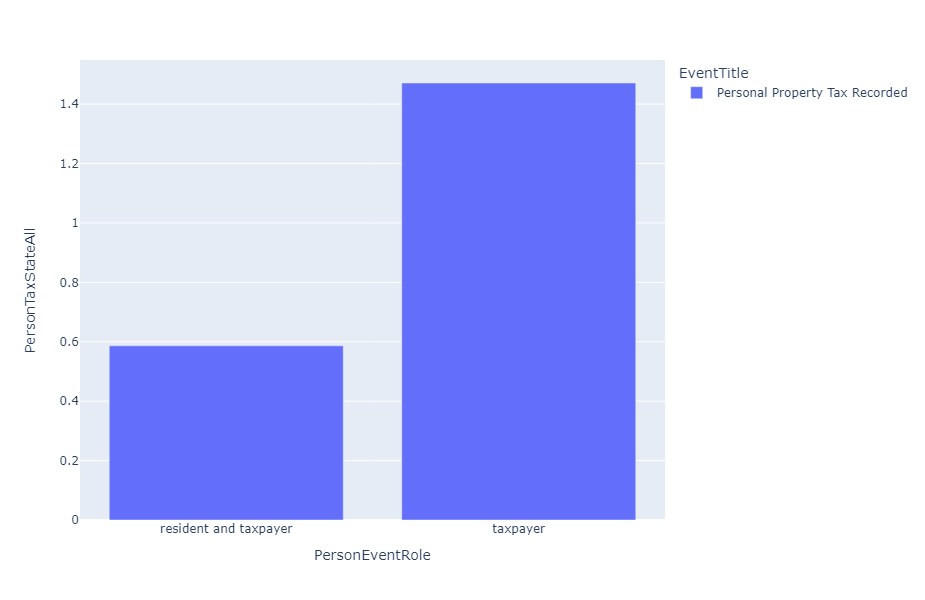

In [162]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'EventTitle', 'mean', 'bar')

In [163]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'mean', 'bar')

Please specify a numeric y-value variable, not a categorical one.


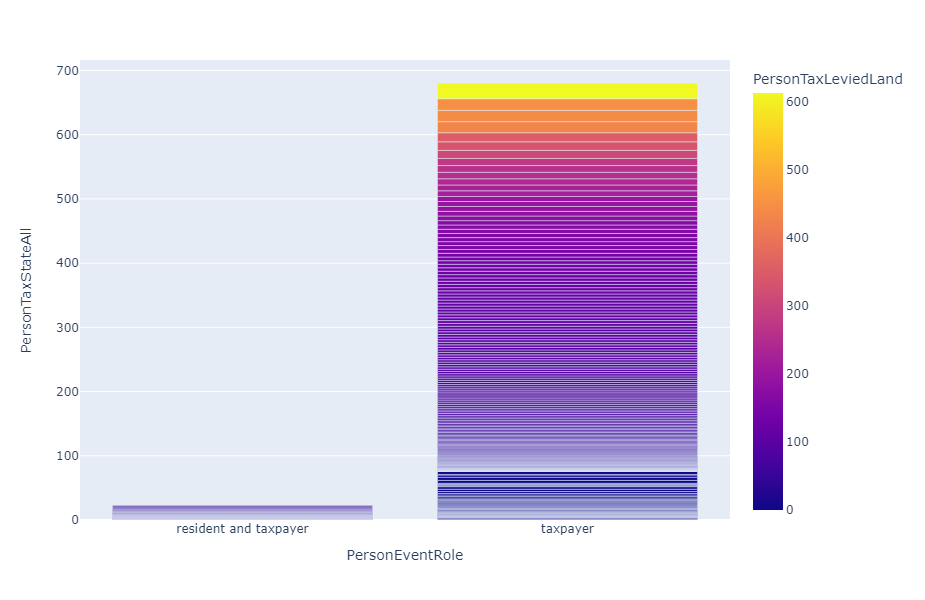

In [164]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'mean', 'bar')

In [165]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle', 'count', 'bar')

Please specify a numeric y-value variable, not a categorical one.


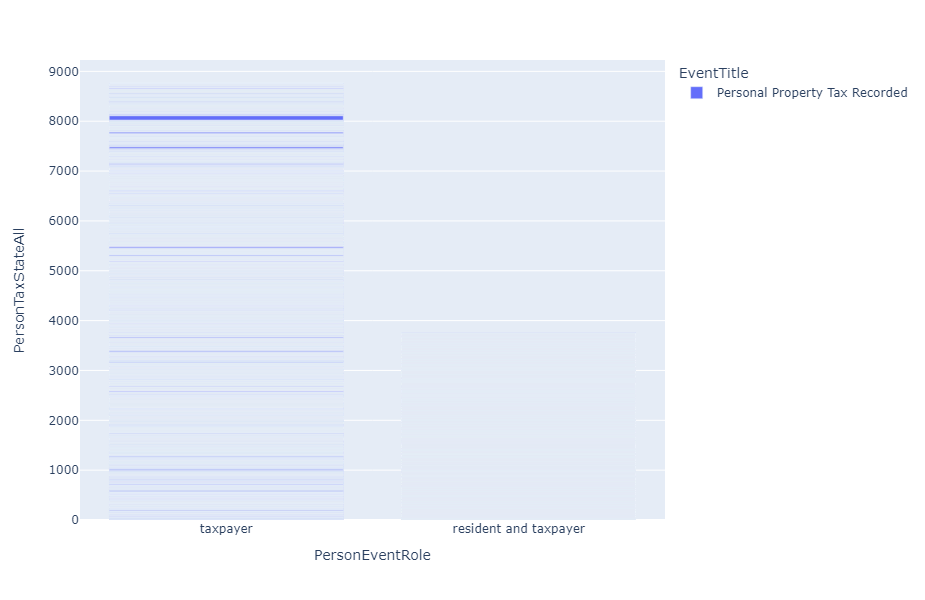

In [166]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'EventTitle', 'count', 'bar')

In [167]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'count', 'bar')

Please specify a numeric y-value variable, not a categorical one.


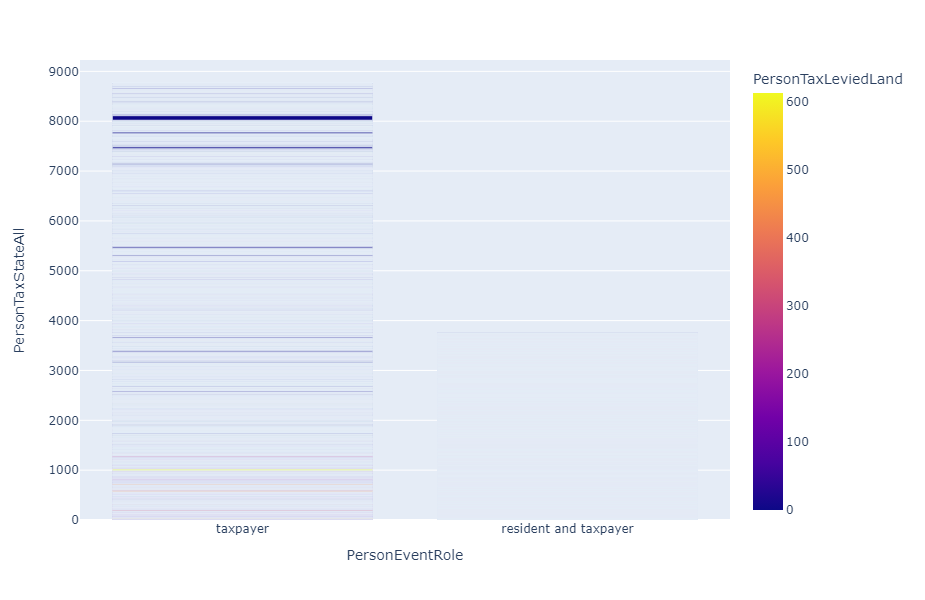

In [168]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'count', 'bar')

In [169]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle', 'median', 'bar')

Please specify a numeric y-value variable, not a categorical one.


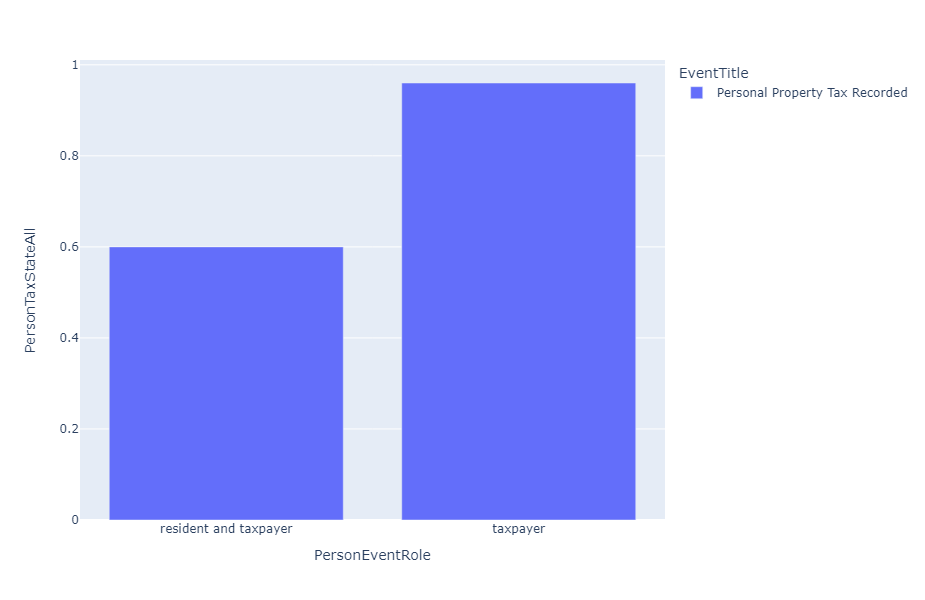

In [170]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'EventTitle', 'median', 'bar')

In [171]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'median', 'bar')

Please specify a numeric y-value variable, not a categorical one.


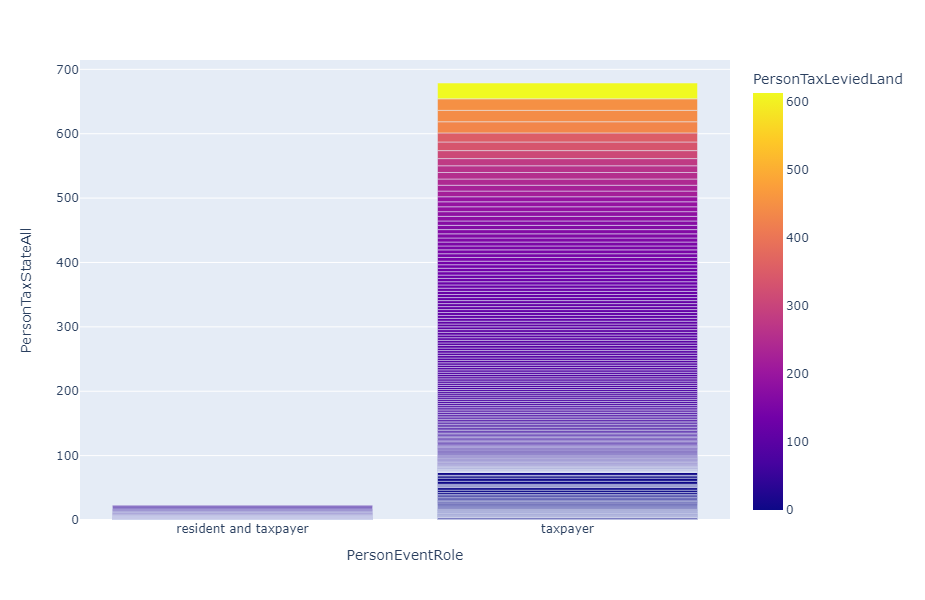

In [172]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'median', 'bar')

In [173]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [174]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'EventTitle', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [175]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [176]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [177]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [178]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'EventTitle', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [179]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [180]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [181]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [182]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'EventTitle', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [183]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [184]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [185]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle', 'mean', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [186]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'EventTitle', 'mean', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [187]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'mean', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [188]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'mean', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [189]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle', 'count', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [190]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'EventTitle', 'count', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [191]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'count', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [192]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'count', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [193]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'EventTitle', 'median', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [194]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'EventTitle', 'median', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [195]:
graph_new('PersonEventRole', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'median', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [196]:
graph_new('PersonEventRole', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'median', 'scatter')

Please specify a numeric x-value variable, not a categorical one.


In [197]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'EventTitle', 'mean', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [198]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'EventTitle', 'mean', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [199]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'mean', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [200]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'mean', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [201]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'EventTitle', 'median', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [202]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'EventTitle', 'median', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [203]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'median', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [204]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'median', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [205]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'EventTitle', 'count', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [206]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'EventTitle', 'count', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [207]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'count', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [208]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'count', 'bar')

Please specify a categorical x-value variable, not a numeric one.


In [209]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'EventTitle', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [210]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'EventTitle', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [211]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [212]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'mean', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [213]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'EventTitle', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [214]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'EventTitle', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [215]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [216]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'median', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [217]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'EventTitle', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [218]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'EventTitle', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [219]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [221]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'count', 'tab')

To create a table, don't select an aggregation function. If you want to use one, consider a bar chart or scatter plot.


In [222]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'EventTitle', 'mean', 'scatter')

Please specify a numeric y-value variable, not a categorical one.


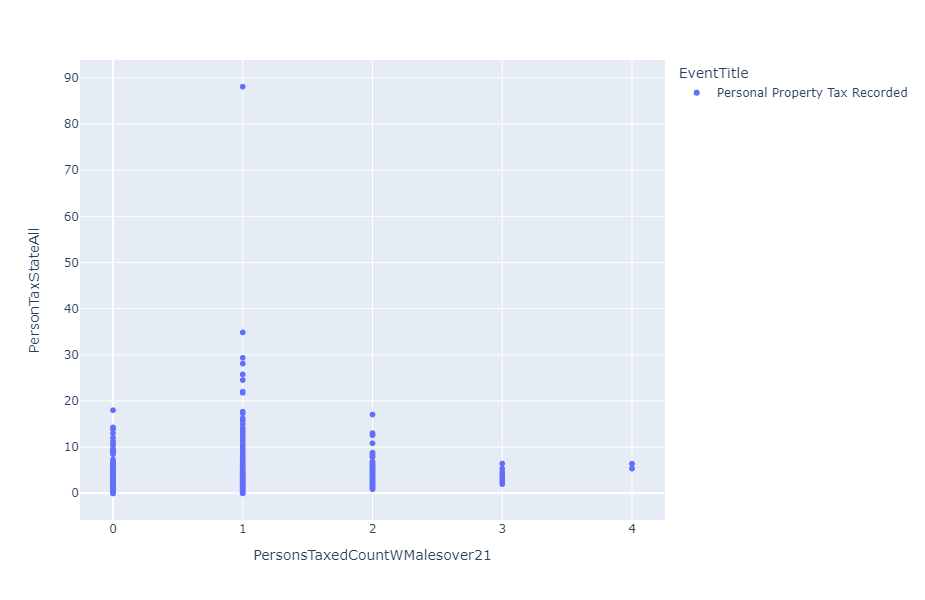

In [223]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'EventTitle', 'mean', 'scatter')

In [224]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'mean', 'scatter')

Please specify a numeric y-value variable, not a categorical one.


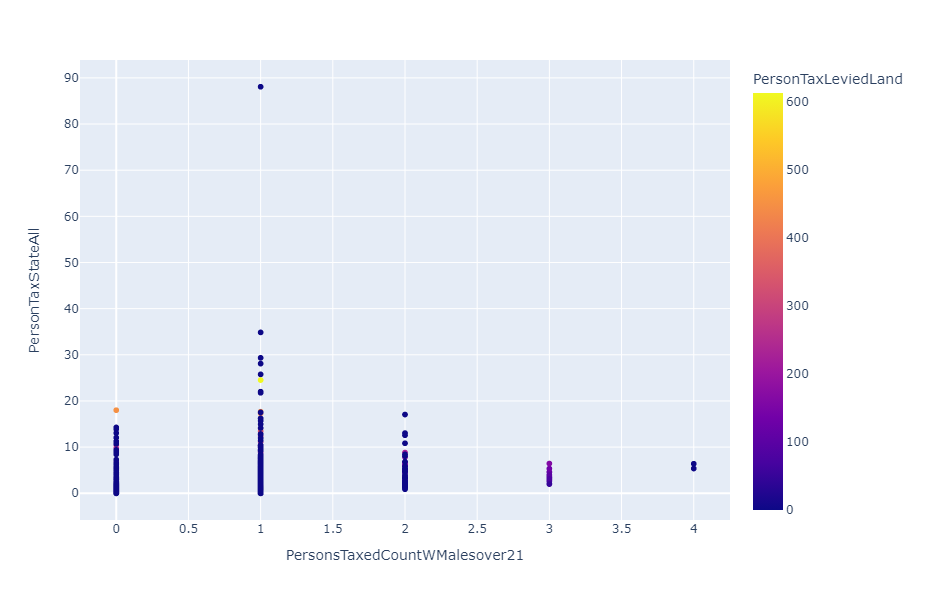

In [225]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'mean', 'scatter')

In [226]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'EventTitle', 'median', 'scatter')

Please specify a numeric y-value variable, not a categorical one.


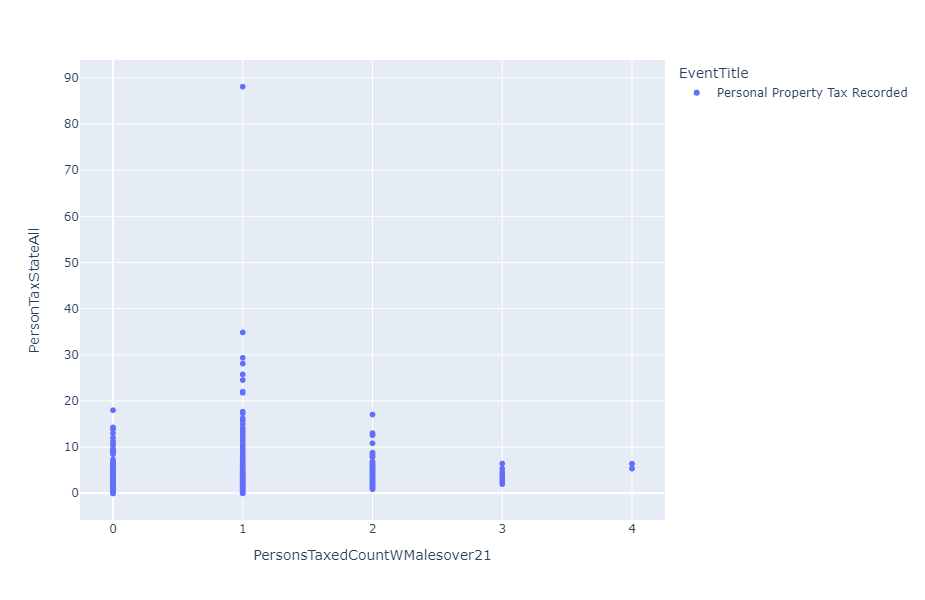

In [227]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'EventTitle', 'median', 'scatter')

In [228]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'median', 'scatter')

Please specify a numeric y-value variable, not a categorical one.


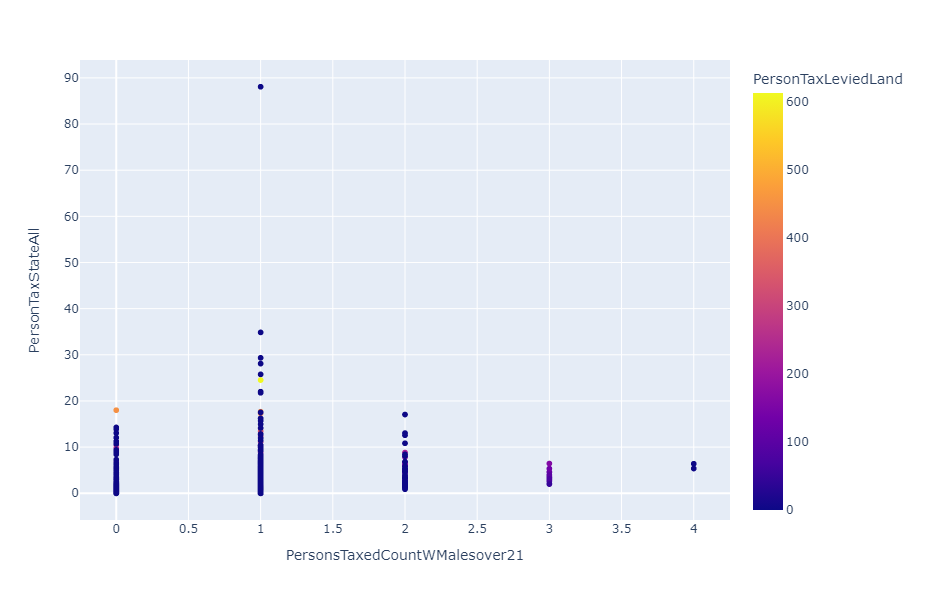

In [229]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'median', 'scatter')

In [230]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'EventTitle', 'count', 'scatter')

Please specify a numeric y-value variable, not a categorical one.


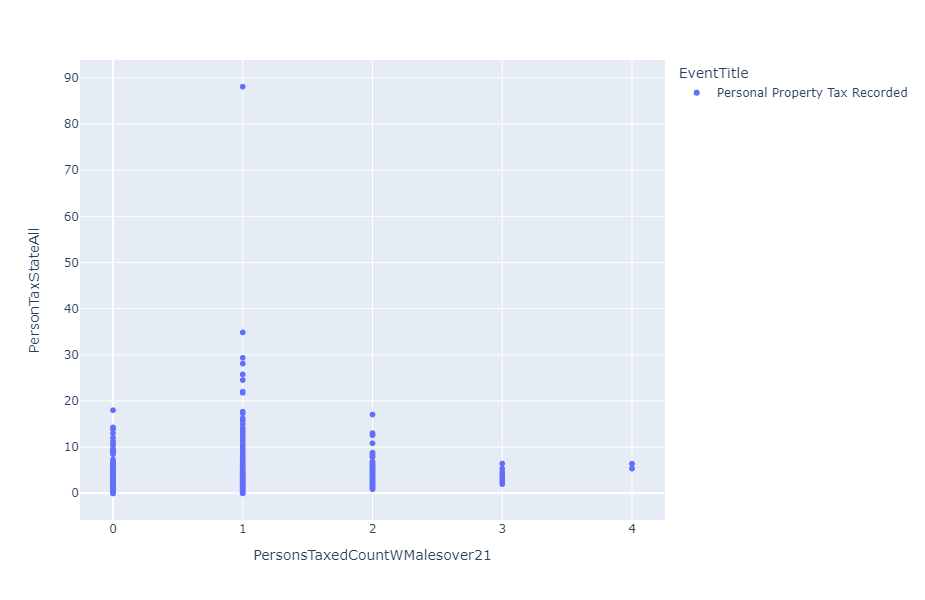

In [231]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'EventTitle', 'count', 'scatter')

In [232]:
graph_new('PersonsTaxedCountWMalesover21', 'EventLocJurisdictionCounty', 'PersonTaxLeviedLand', 'count', 'scatter')

Please specify a numeric y-value variable, not a categorical one.


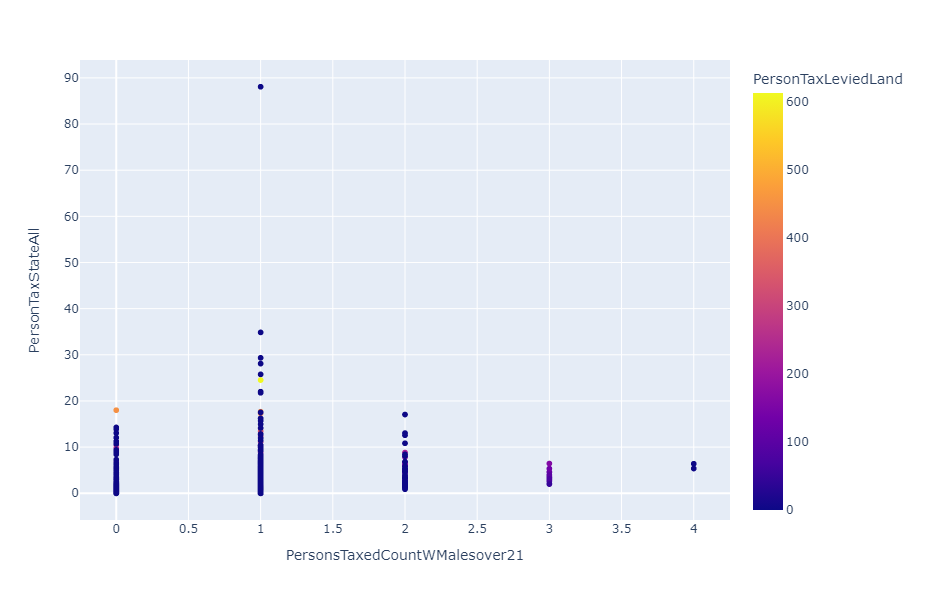

In [233]:
graph_new('PersonsTaxedCountWMalesover21', 'PersonTaxStateAll', 'PersonTaxLeviedLand', 'count', 'scatter')

### Results

**The new function passed all tests!**